<a href="https://colab.research.google.com/github/PenelopeRosswillTMU/CIND820_Capstone/blob/main/CIND_820_ED_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import missingno
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

In [3]:
#uploading dataset from survey
dataset_url = 'https://raw.githubusercontent.com/PenelopeRosswillTMU/CIND820_Capstone/main/sondage_communautes_lgbtq2plus.csv?token=GHSAT0AAAAAACDVSARJMJO74J6FUAERHAECZEIUP6Q'
df_fr = pd.read_csv(dataset_url)

In [16]:
df_fr.info()
df_fr.head()
for i in range(len(df_fr.columns)):
  print(df_fr.columns[i],": ",type(df_fr.columns[i]))


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1448 entries, 0 to 1447
Columns: 123 entries, id to interet_participer_groupe_discussion_q40
dtypes: category(32), int64(11), object(80)
memory usage: 1.1+ MB


,id,acces_services _ Ville_q1,acces_services _ Ville_q2_1,acces_services _ Ville_q2_2,acces_services _ Ville_q2_3,acces_services _ Ville_q2_4,acces_services _ Ville_q2_5,acces_services _ Ville_q2_6,acces_services _ Ville_q2_7,acces_services _ Ville_q2_8,...,profil_q30,profil_q31,profil_q32,profil_q33,profil_q34,profil_q35,profil_q36,profil_q37,interet_participer_groupe_discussion_q38,interet_participer_groupe_discussion_q40
0,1,Oui,Bibliothèques municipales,NaN,NaN,NaN,NaN,Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Autres (veuillez préciser),Autres (veuillez préciser),Anglais,Non,Non,Non,H2J,Autres (veuillez préciser),Non,NaN
1,2,Oui,Bibliothèques municipales,Bureaux Accès Montréal,Bureaux Accès culture ou Maisons de la culture,Bureaux Accès culture ou Maisons de la culture,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,Ligne téléphonique 311,...,Par le biais d’un organisme ou d’une association,Par le biais d’un organisme ou d’une association,Français,Non,Non,Non,H3K,Par le biais d’un organisme ou d’une association,Non,NaN
2,3,Oui,Bibliothèques municipales,NaN,NaN,NaN,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Par une personne de mon entourage,Par une personne de mon entourage,Anglais,Oui,Oui,Non,H2K,Par une personne de mon entourage,Non,NaN
3,4,Oui,Bibliothèques municipales,NaN,NaN,NaN,NaN,Réseau des parcs de quartier et grands parcs,Jardins communautaires,NaN,...,Par une personne de mon entourage,Par une personne de mon entourage,Anglais,Non,Oui,Non,Je n’ai pas de domicile fixe,Par une personne de mon entourage,Non,NaN
4,5,Oui,Bibliothèques municipales,NaN,Bureaux Accès culture ou Maisons de la culture,Bureaux Accès culture ou Maisons de la culture,NaN,Réseau des parcs de quartier et grands parcs,NaN,Ligne téléphonique 311,...,Invitation de la Ville reçue par courriel,Invitation de la Ville reçue par courriel,Français,Non,Non,Non,H1V,Invitation de la Ville reçue par courriel,Oui,Non


In [12]:
#setting data types

#set categorical data
df_fr[' acces_services _ Ville_q3'] = df_fr[' acces_services _ Ville_q3'].astype('category')
df_fr[' acces_services _ Ville_q4'] = df_fr[' acces_services _ Ville_q4'].astype('category')
df_fr[' acces_services _ Ville_q5'] = df_fr[' acces_services _ Ville_q5'].astype('category')
df_fr[' acces_services _ Ville_q7_1'] = df_fr[' acces_services _ Ville_q7_1'].astype('category')
df_fr[' acces_services _ Ville_q7_2'] = df_fr[' acces_services _ Ville_q7_2'].astype('category')
df_fr[' acces_services _ Ville_q7_3'] = df_fr[' acces_services _ Ville_q7_3'].astype('category')
df_fr[' acces_services _ Ville_q7_4'] = df_fr[' acces_services _ Ville_q7_4'].astype('category')
df_fr[' acces_services _ Ville_q7_5'] = df_fr[' acces_services _ Ville_q7_5'].astype('category')
df_fr[' acces_services _ Ville_q8_1'] = df_fr[' acces_services _ Ville_q8_1'].astype('category')
df_fr[' acces_services _ Ville_q8_2'] = df_fr[' acces_services _ Ville_q8_2'].astype('category')
df_fr[' acces_services _ Ville_q8_3'] = df_fr[' acces_services _ Ville_q8_3'].astype('category')
df_fr[' acces_services _ Ville_q8_4'] = df_fr[' acces_services _ Ville_q8_4'].astype('category')
df_fr[' acces_services _ Ville_q8_5'] = df_fr[' acces_services _ Ville_q8_5'].astype('category')
df_fr[' acces_services _ Ville_q9'] = df_fr[' acces_services _ Ville_q9'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_1'] = df_fr['milieu_et_qualite_de_vie_q11_1'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_2'] = df_fr['milieu_et_qualite_de_vie_q11_2'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_3'] = df_fr['milieu_et_qualite_de_vie_q11_3'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_4'] = df_fr['milieu_et_qualite_de_vie_q11_4'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_5'] = df_fr['milieu_et_qualite_de_vie_q11_5'].astype('category')
df_fr['milieu_et_qualité_de_vie_q11_6'] = df_fr['milieu_et_qualité_de_vie_q11_6'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_7'] = df_fr['milieu_et_qualite_de_vie_q11_7'].astype('category')
df_fr['milieu_et_qualite_de_vie_q11_8'] = df_fr['milieu_et_qualite_de_vie_q11_8'].astype('category')
df_fr['securité_dans_espace_public_q16'] = df_fr['securité_dans_espace_public_q16'].astype('category')
df_fr['securité_dans_espace_public_q18'] = df_fr['securité_dans_espace_public_q18'].astype('category')
df_fr['profil_q25'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q26'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q27'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q28'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q29'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q30'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q31'] = df_fr['profil_q25'].astype('category')
df_fr['profil_q37'] = df_fr['profil_q25'].astype('category')

#set integer data
df_fr['piste_action_q22_1'] = df_fr['piste_action_q22_1'].astype('int')
df_fr['piste_action_q22_2'] = df_fr['piste_action_q22_2'].astype('int')
df_fr['piste_action_q22_3'] = df_fr['piste_action_q22_3'].astype('int')
df_fr['piste_action_q22_4'] = df_fr['piste_action_q22_4'].astype('int')
df_fr['piste_action_q22_5'] = df_fr['piste_action_q22_5'].astype('int')
df_fr['piste_action_q22_6'] = df_fr['piste_action_q22_6'].astype('int')
df_fr['piste_action_q22_7'] = df_fr['piste_action_q22_7'].astype('int')
df_fr['piste_action_q22_8'] = df_fr['piste_action_q22_8'].astype('int')
df_fr['piste_action_q22_9'] = df_fr['piste_action_q22_9'].astype('int')
df_fr['piste_action_q22_10'] = df_fr['piste_action_q22_10'].astype('int')

In [13]:
def time_series_plot(df):
    """Given dataframe, generate times series plot of numeric data by daily, monthly and yearly frequency"""
    print("\nTo check time series of numeric data  by daily, monthly and yearly frequency")
    if len(df.select_dtypes(include='datetime64').columns)>0:
        for col in df.select_dtypes(include='datetime64').columns:
            for p in ['D', 'M', 'Y']:
                if p=='D':
                    print("Plotting daily data")
                elif p=='M':
                    print("Plotting monthly data")
                else:
                    print("Plotting yearly data")
                for col_num in df.select_dtypes(include=np.number).columns:
                    __ = df.copy()
                    __ = __.set_index(col)
                    __T = __.resample(p).sum()
                    ax = __T[[col_num]].plot()
                    ax.set_ylim(bottom=0)
                    ax.get_yaxis().set_major_formatter(
                    matplotlib.ticker.FuncFormatter(lambda x, p: format(int(x), ',')))
                    plt.show()


def numeric_eda(df, hue=None):
    """Given dataframe, generate EDA of numeric data"""
    print("\nTo check: \nDistribution of numeric data")
    display(df.describe().T)
    columns = df.select_dtypes(include=np.number).columns
    figure = plt.figure(figsize=(20, 10))
    figure.add_subplot(1, len(columns), 1)
    for index, col in enumerate(columns):
        if index > 0:
            figure.add_subplot(1, len(columns), index + 1)
        sns.boxplot(y=col, data=df, boxprops={'facecolor': 'None'})
    figure.tight_layout()
    plt.show()

    if len(df.select_dtypes(include='category').columns) > 0:
        for col_num in df.select_dtypes(include=np.number).columns:
            for col in df.select_dtypes(include='category').columns:
                fig = sns.catplot(x=col, y=col_num, kind='violin', data=df, height=5, aspect=2)
                fig.set_xticklabels(rotation=90)
                plt.show()

    # Plot the pairwise joint distributions
    print("\nTo check pairwise joint distribution of numeric data")
    if hue==None:
        sns.pairplot(df.select_dtypes(include=np.number))
    else:
        sns.pairplot(df.select_dtypes(include=np.number).join(df[[hue]]), hue=hue)
    plt.show()


def top5(df):
    """Given dataframe, generate top 5 unique values for non-numeric data"""
    columns = df.select_dtypes(include=['object', 'category']).columns
    for col in columns:
        print("Top 5 unique values of " + col)
        print(df[col].value_counts().reset_index().rename(columns={"index": col, col: "Count"})[
              :min(5, len(df[col].value_counts()))])
        print(" ")


def categorical_eda(df, hue=None):
    """Given dataframe, generate EDA of categorical data"""
    print("\nTo check: \nUnique count of non-numeric data\n")
    print(df.select_dtypes(include=['object', 'category']).nunique())
    top5(df)
    # Plot count distribution of categorical data
    for col in df.select_dtypes(include='category').columns:
        fig = sns.catplot(x=col, kind="count", data=df, hue=hue)
        fig.set_xticklabels(rotation=90)
        plt.show()


def eda(df):
    """Given dataframe, generate exploratory data analysis"""
    # check that input is pandas dataframe
    if type(df) != pd.core.frame.DataFrame:
        raise TypeError("Only pandas dataframe is allowed as input")

    # replace field that's entirely space (or empty) with NaN
    df = df.replace(r'^\s*$', np.nan, regex=True)

    print("Preview of data:")
    display(df.head(3))

    print("\nTo check: \n (1) Total number of entries \n (2) Column types \n (3) Any null values\n")
    print(df.info())

    # generate preview of entries with null values
    if df.isnull().any(axis=None):
        print("\nPreview of data with null values:")
        display(df[df.isnull().any(axis=1)].head(3))
        missingno.matrix(df)
        plt.show()

    # generate count statistics of duplicate entries
    if len(df[df.duplicated()]) > 0:
        print("\n***Number of duplicated entries: ", len(df[df.duplicated()]))
        display(df[df.duplicated(keep=False)].sort_values(by=list(df.columns)).head())
    else:
        print("\nNo duplicated entries found")

    # EDA of categorical data
    categorical_eda(df)

    # EDA of numeric data
    numeric_eda(df)

    # Plot time series plot of numeric data
    time_series_plot(df)

Preview of data:


,id,acces_services _ Ville_q1,acces_services _ Ville_q2_1,acces_services _ Ville_q2_2,acces_services _ Ville_q2_3,acces_services _ Ville_q2_4,acces_services _ Ville_q2_5,acces_services _ Ville_q2_6,acces_services _ Ville_q2_7,acces_services _ Ville_q2_8,...,profil_q30,profil_q31,profil_q32,profil_q33,profil_q34,profil_q35,profil_q36,profil_q37,interet_participer_groupe_discussion_q38,interet_participer_groupe_discussion_q40
0,1,Oui,Bibliothèques municipales,NaN,NaN,NaN,NaN,Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Autres (veuillez préciser),Autres (veuillez préciser),Anglais,Non,Non,Non,H2J,Autres (veuillez préciser),Non,NaN
1,2,Oui,Bibliothèques municipales,Bureaux Accès Montréal,Bureaux Accès culture ou Maisons de la culture,Bureaux Accès culture ou Maisons de la culture,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,Ligne téléphonique 311,...,Par le biais d’un organisme ou d’une association,Par le biais d’un organisme ou d’une association,Français,Non,Non,Non,H3K,Par le biais d’un organisme ou d’une association,Non,NaN
2,3,Oui,Bibliothèques municipales,NaN,NaN,NaN,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Par une personne de mon entourage,Par une personne de mon entourage,Anglais,Oui,Oui,Non,H2K,Par une personne de mon entourage,Non,NaN



To check: 
 (1) Total number of entries 
 (2) Column types 
 (3) Any null values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1448 entries, 0 to 1447
Columns: 123 entries, id to interet_participer_groupe_discussion_q40
dtypes: category(32), int64(11), object(80)
memory usage: 1.1+ MB
None

Preview of data with null values:


,id,acces_services _ Ville_q1,acces_services _ Ville_q2_1,acces_services _ Ville_q2_2,acces_services _ Ville_q2_3,acces_services _ Ville_q2_4,acces_services _ Ville_q2_5,acces_services _ Ville_q2_6,acces_services _ Ville_q2_7,acces_services _ Ville_q2_8,...,profil_q30,profil_q31,profil_q32,profil_q33,profil_q34,profil_q35,profil_q36,profil_q37,interet_participer_groupe_discussion_q38,interet_participer_groupe_discussion_q40
0,1,Oui,Bibliothèques municipales,NaN,NaN,NaN,NaN,Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Autres (veuillez préciser),Autres (veuillez préciser),Anglais,Non,Non,Non,H2J,Autres (veuillez préciser),Non,NaN
1,2,Oui,Bibliothèques municipales,Bureaux Accès Montréal,Bureaux Accès culture ou Maisons de la culture,Bureaux Accès culture ou Maisons de la culture,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,Ligne téléphonique 311,...,Par le biais d’un organisme ou d’une association,Par le biais d’un organisme ou d’une association,Français,Non,Non,Non,H3K,Par le biais d’un organisme ou d’une association,Non,NaN
2,3,Oui,Bibliothèques municipales,NaN,NaN,NaN,"Centres sportifs et de loisirs (piscines, terr...",Réseau des parcs de quartier et grands parcs,NaN,NaN,...,Par une personne de mon entourage,Par une personne de mon entourage,Anglais,Oui,Oui,Non,H2K,Par une personne de mon entourage,Non,NaN


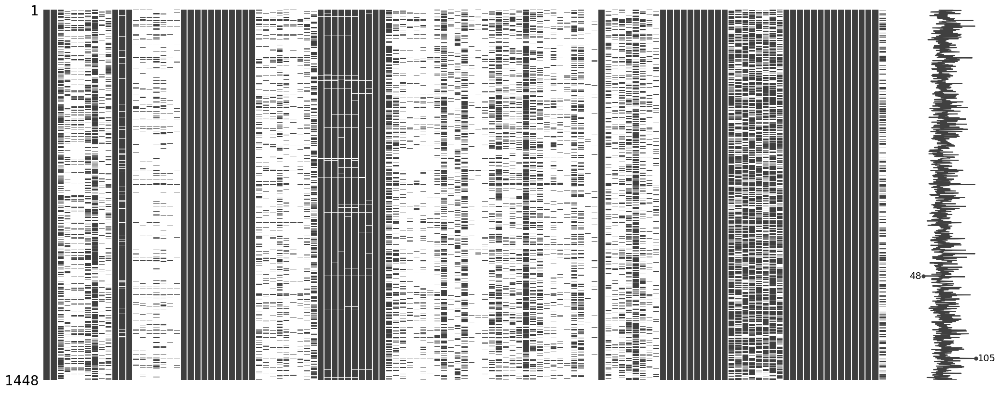


No duplicated entries found

To check: 
Unique count of non-numeric data

 acces_services _ Ville_q1                    2
 acces_services _ Ville_q2_1                  1
 acces_services _ Ville_q2_2                  1
 acces_services _ Ville_q2_3                  1
 acces_services _ Ville_q2_4                  1
                                           ... 
profil_q35                                    2
profil_q36                                  279
profil_q37                                    7
interet_participer_groupe_discussion_q38      2
interet_participer_groupe_discussion_q40      2
Length: 112, dtype: int64
Top 5 unique values of  acces_services _ Ville_q1
   acces_services _ Ville_q1  Count
0                        Oui   1216
1                        Non    232
 
Top 5 unique values of  acces_services _ Ville_q2_1
   acces_services _ Ville_q2_1  Count
0    Bibliothèques municipales    716
 
Top 5 unique values of  acces_services _ Ville_q2_2
   acces_services _ Ville_q2_

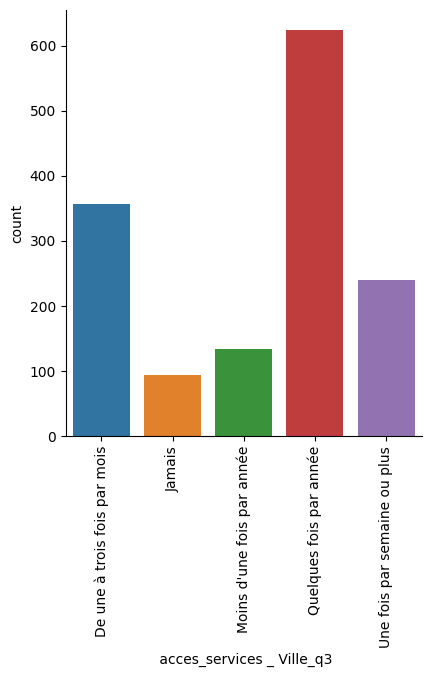

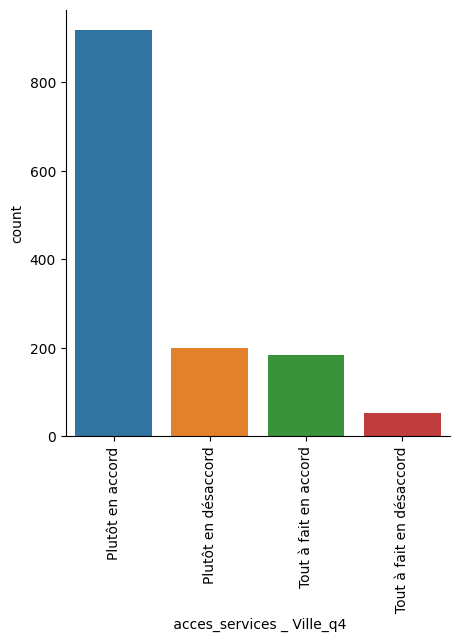

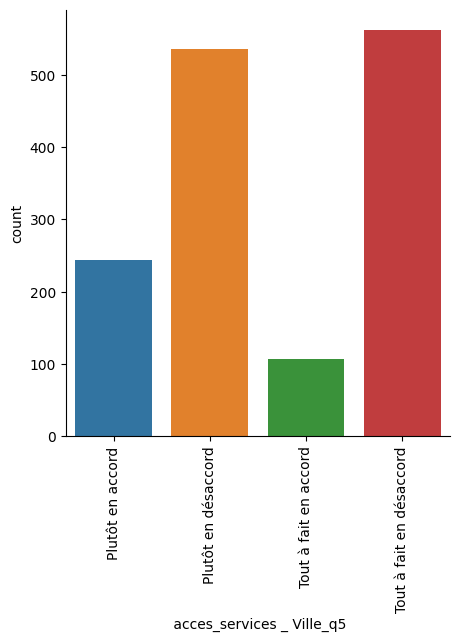

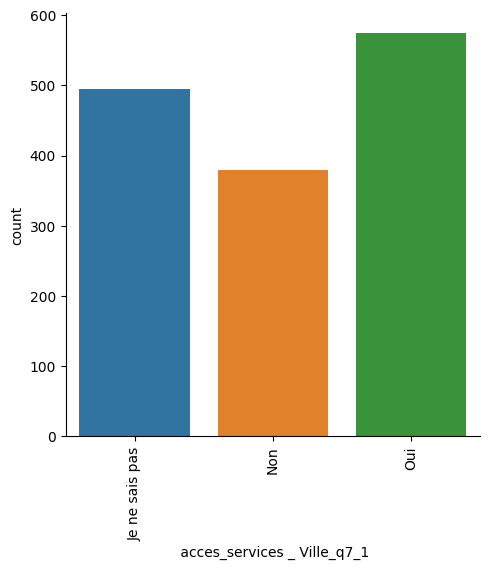

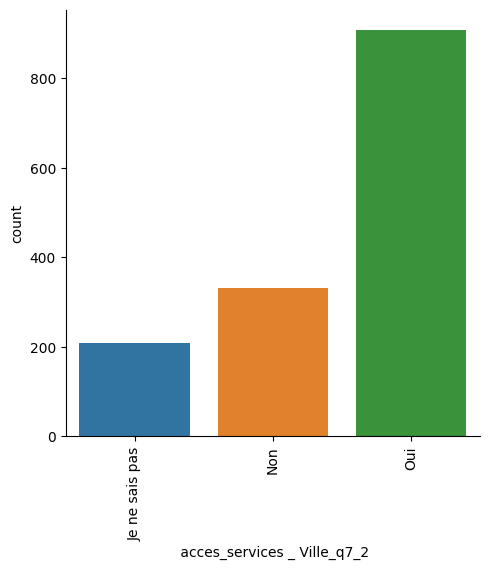

...

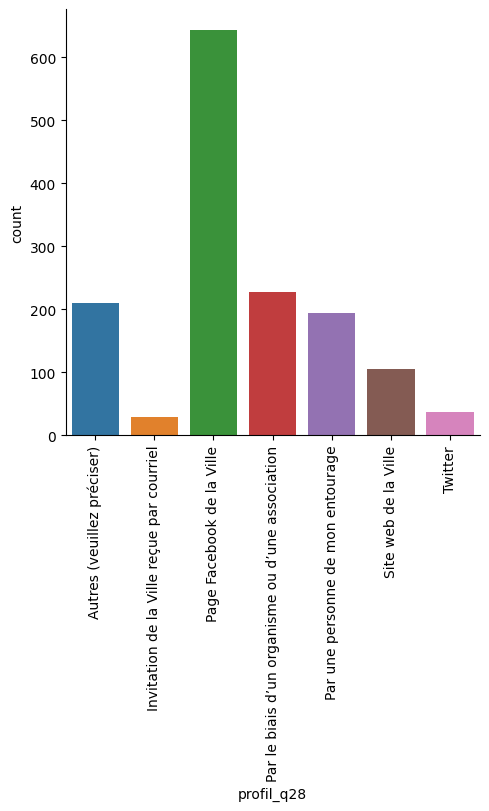

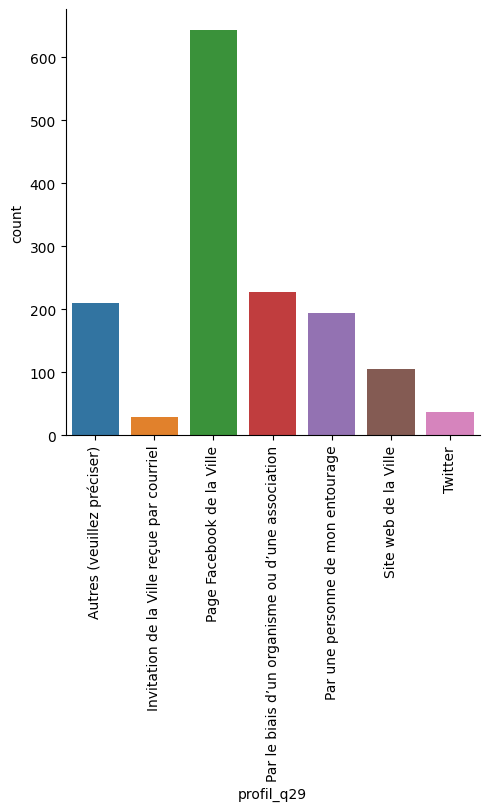

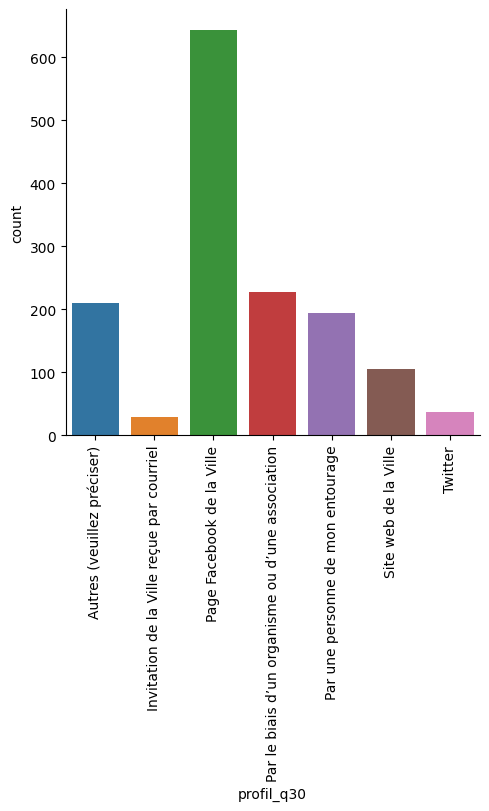

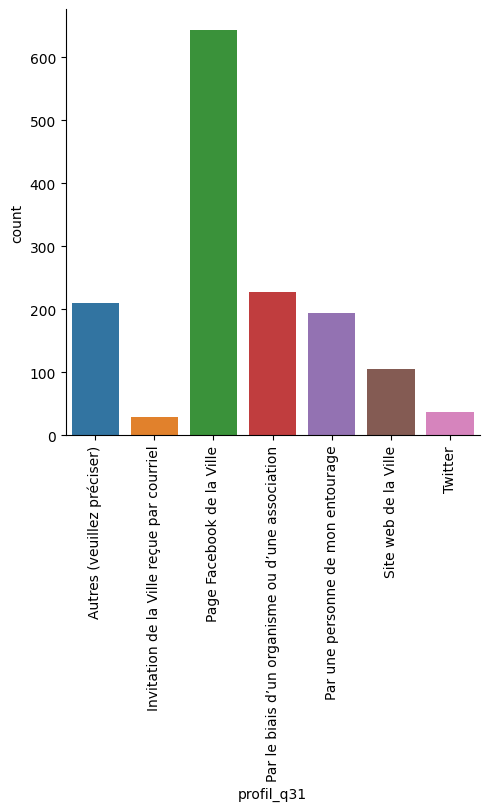

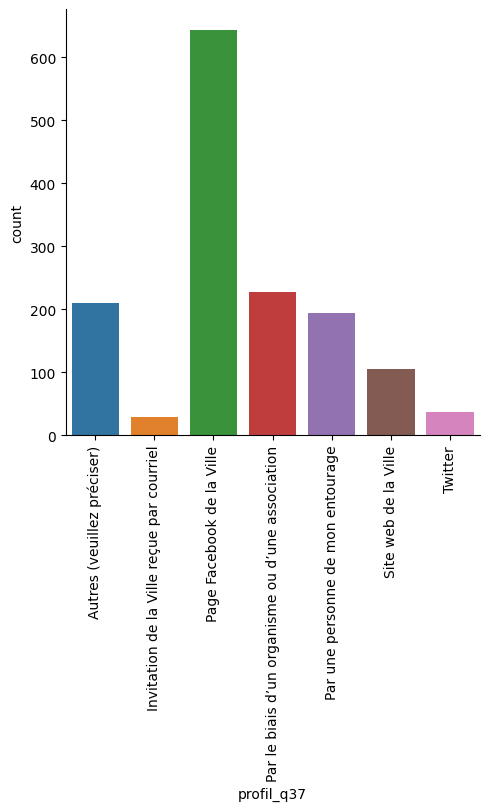


To check: 
Distribution of numeric data


,count,mean,std,min,25%,50%,75%,max
id,1448.0,724.500000,418.145908,1.0,362.75,724.5,1086.25,1448.0
piste_action_q22_1,1448.0,4.341160,2.944249,1.0,2.00,4.0,7.00,10.0
piste_action_q22_2,1448.0,4.541436,3.025064,1.0,2.00,4.0,7.00,10.0
piste_action_q22_3,1448.0,4.314227,2.454848,1.0,2.00,4.0,6.00,10.0
piste_action_q22_4,1448.0,6.090470,2.614503,1.0,4.00,6.0,8.00,10.0
piste_action_q22_5,1448.0,5.424033,2.397540,1.0,4.00,5.0,7.00,10.0
piste_action_q22_6,1448.0,5.546271,2.390505,1.0,4.00,6.0,7.00,10.0
piste_action_q22_7,1448.0,6.169890,2.425134,1.0,4.00,7.0,8.00,10.0
piste_action_q22_8,1448.0,6.171961,2.723136,1.0,4.00,7.0,8.00,10.0
piste_action_q22_9,1448.0,7.395718,2.795773,1.0,5.00,9.0,10.00,10.0


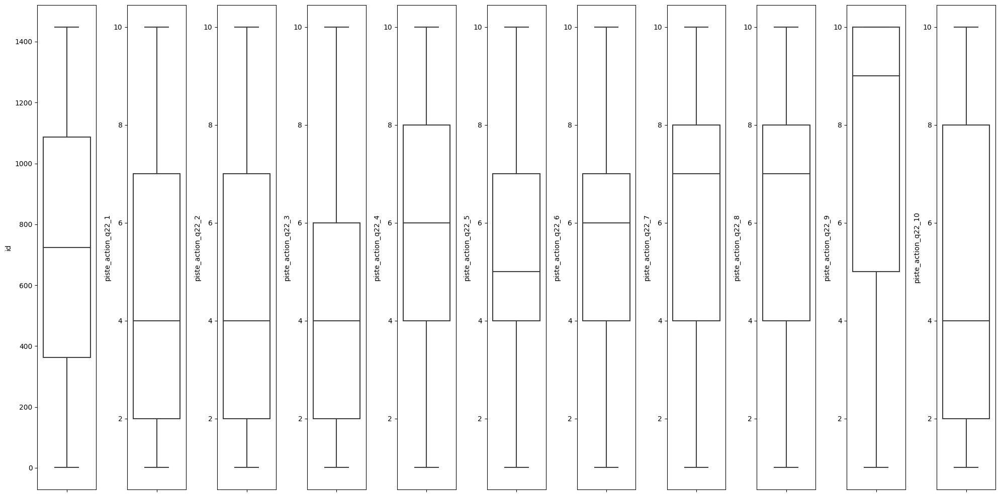

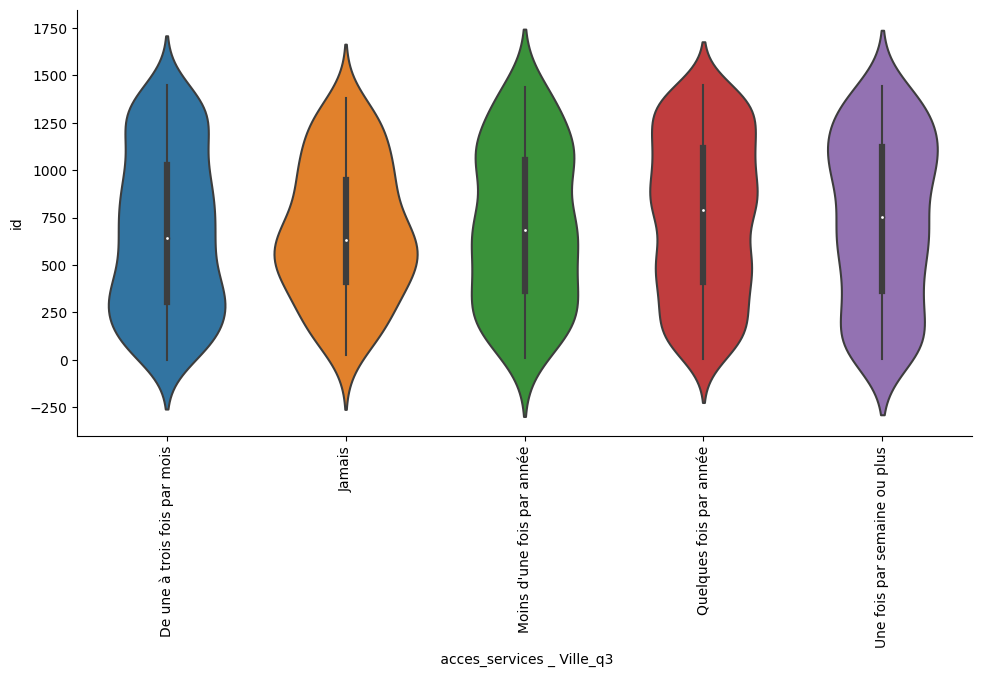

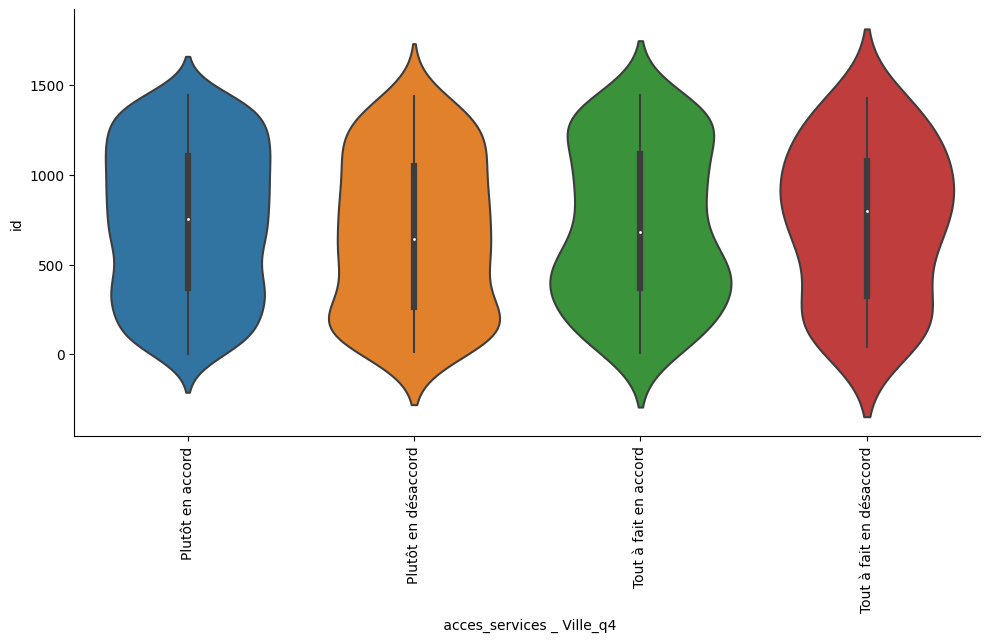

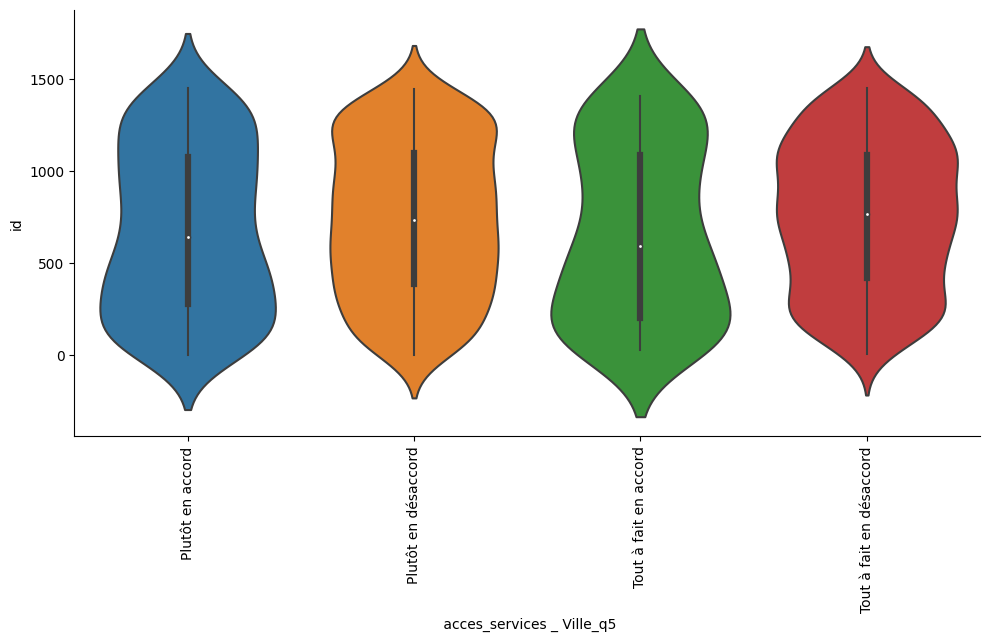

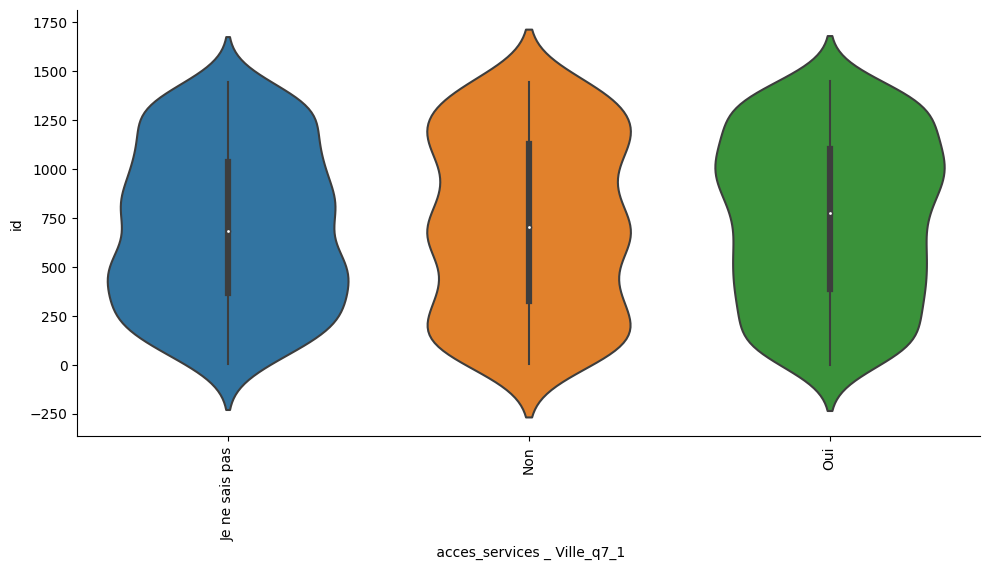

...

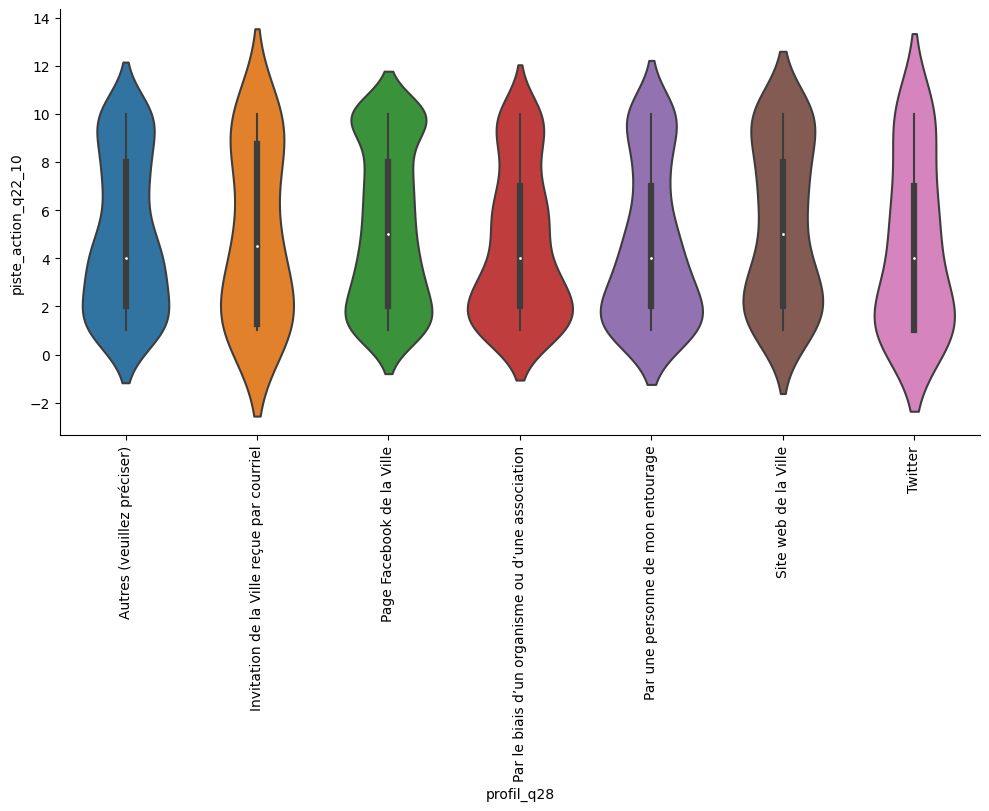

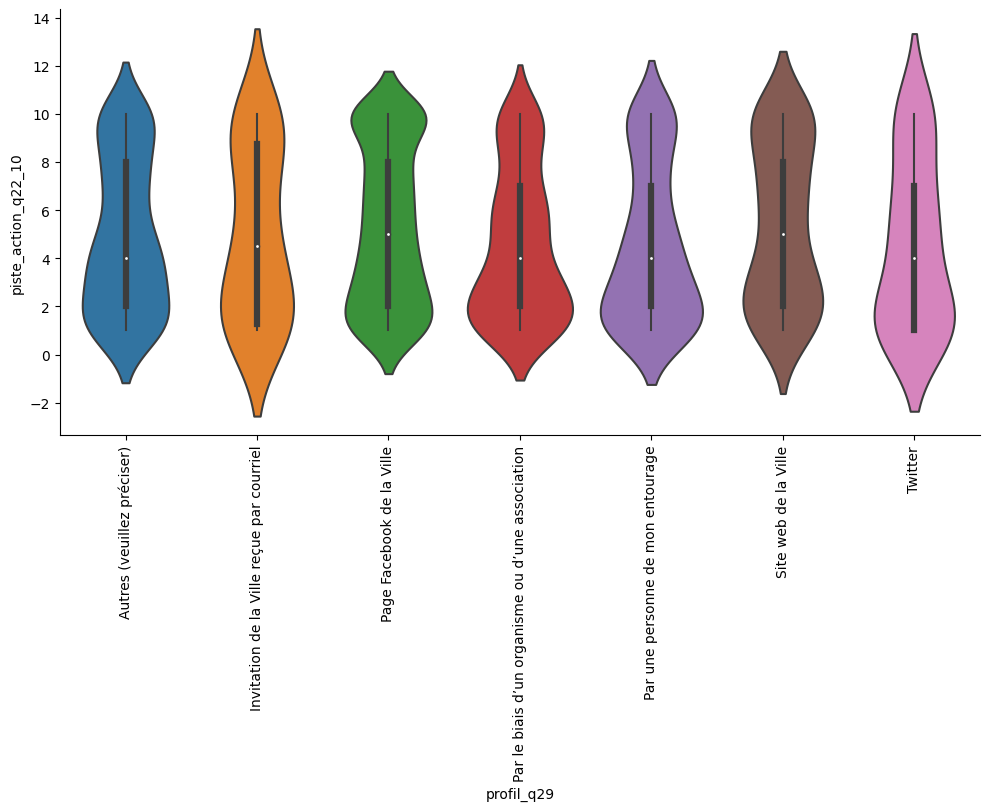

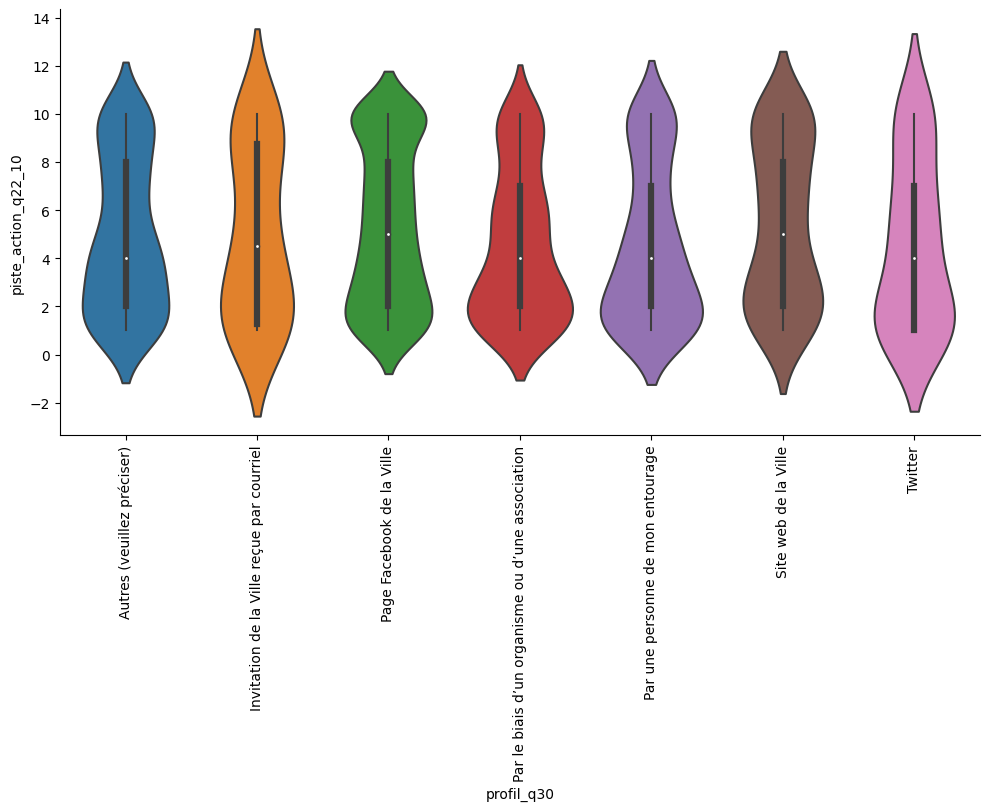

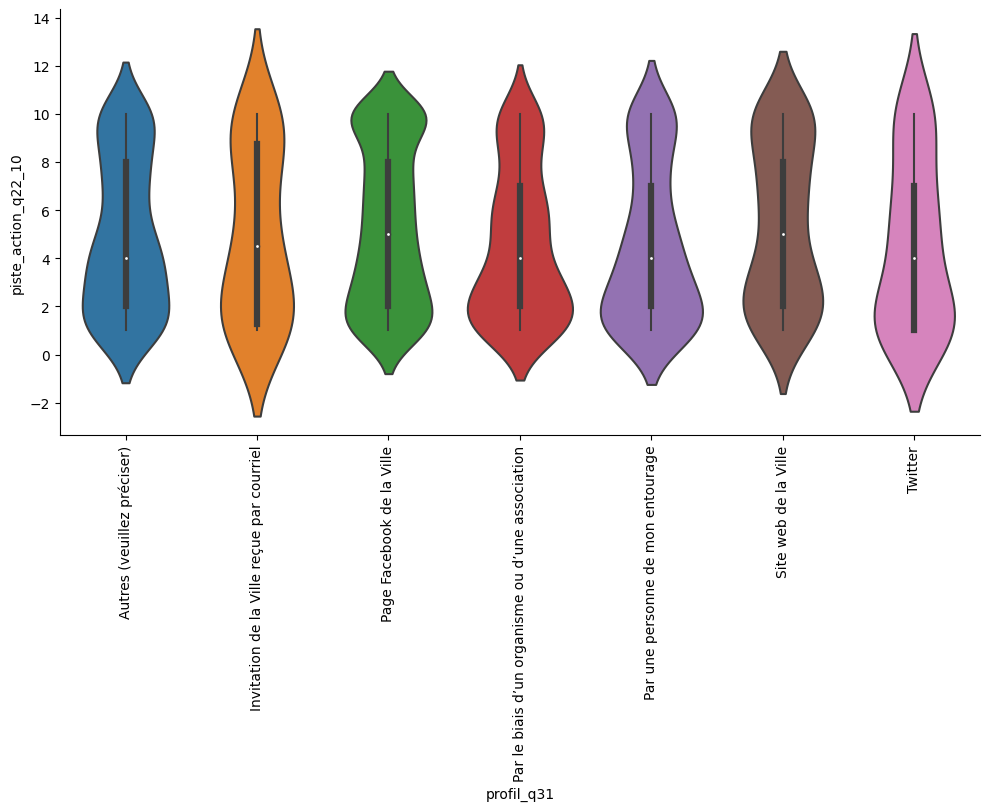

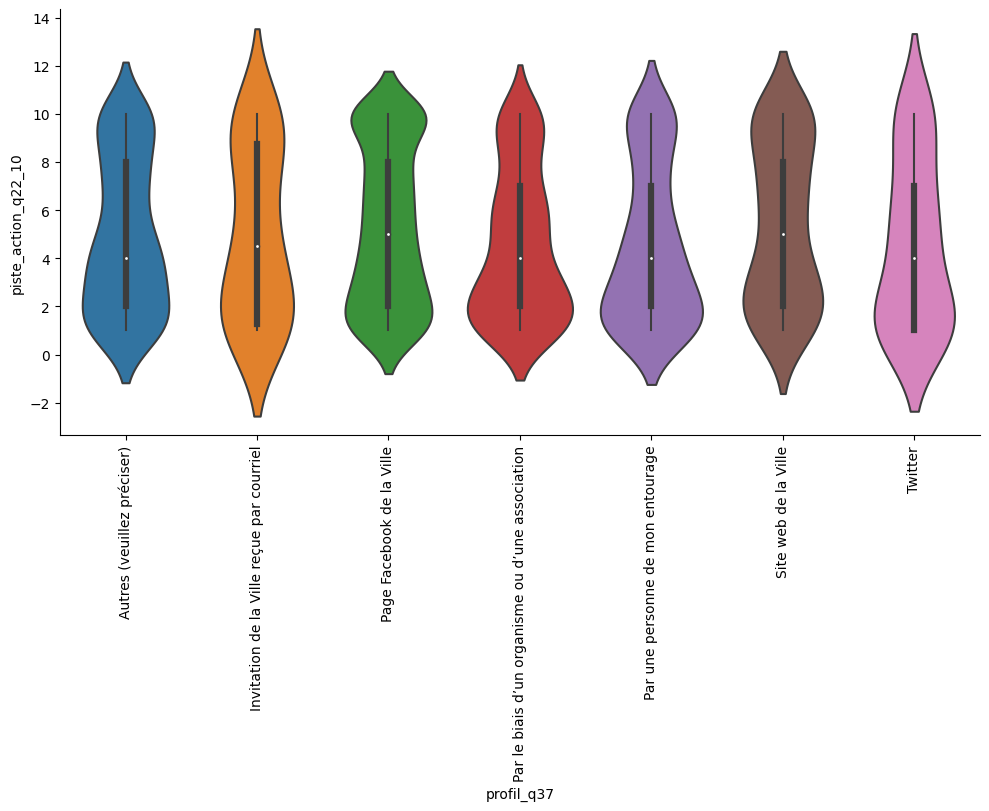


To check pairwise joint distribution of numeric data


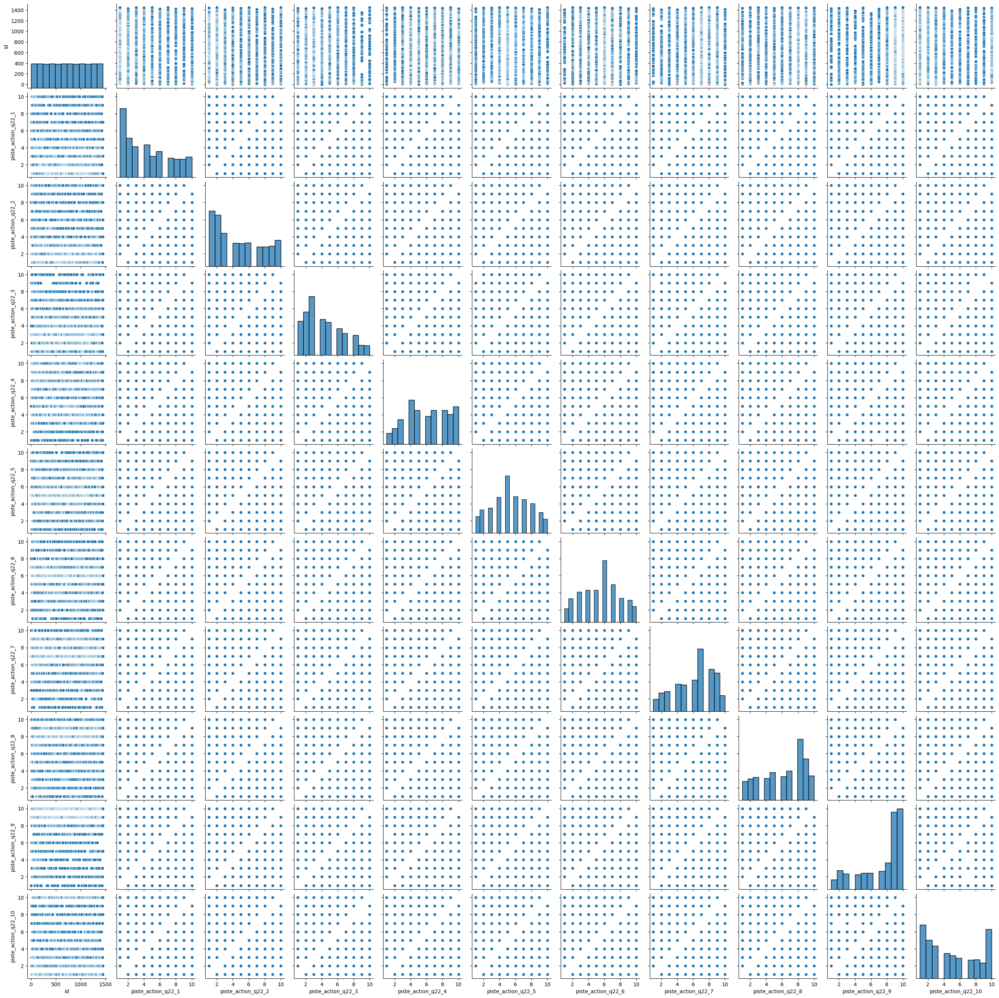


To check time series of numeric data  by daily, monthly and yearly frequency


In [14]:
eda(df_fr)